In [2]:
#challenge 1
import csv
ctr=0
with open("turnstile_150404.txt", "r") as turnstile_data:
    reader=csv.reader(turnstile_data)
    reader.next()
    my_dict={}
    for row in reader:
        key = tuple(row[0:4])
        #print(key)
        #ctr=ctr+1
        #if ctr==200:
         #  break
        
        val = row[4:-1]
        # check if the key, val exists
        if key in my_dict:
            my_dict[key].append(val)
        else:
            my_dict[key] = [val] #for a new key, we simply assign value and continue looping
print my_dict


{('A030', 'R083', '01-06-00', '23 ST-5 AVE'): [['NR', 'BMT', '03/28/2015', '00:00:00', 'REGULAR', '0005767857'], ['NR', 'BMT', '03/28/2015', '04:00:00', 'REGULAR', '0005767940'], ['NR', 'BMT', '03/28/2015', '08:00:00', 'REGULAR', '0005767967'], ['NR', 'BMT', '03/28/2015', '12:00:00', 'REGULAR', '0005768088'], ['NR', 'BMT', '03/28/2015', '16:00:00', 'REGULAR', '0005768421'], ['NR', 'BMT', '03/28/2015', '20:00:00', 'REGULAR', '0005768895'], ['NR', 'BMT', '03/29/2015', '00:00:00', 'REGULAR', '0005769125'], ['NR', 'BMT', '03/29/2015', '04:00:00', 'REGULAR', '0005769188'], ['NR', 'BMT', '03/29/2015', '08:00:00', 'REGULAR', '0005769209'], ['NR', 'BMT', '03/29/2015', '12:00:00', 'REGULAR', '0005769292'], ['NR', 'BMT', '03/29/2015', '16:00:00', 'REGULAR', '0005769545'], ['NR', 'BMT', '03/29/2015', '20:00:00', 'REGULAR', '0005769848'], ['NR', 'BMT', '03/30/2015', '00:00:00', 'REGULAR', '0005770010'], ['NR', 'BMT', '03/30/2015', '04:00:00', 'REGULAR', '0005770033'], ['NR', 'BMT', '03/30/2015', '

In [3]:
#challenge 2
from datetime import *
from dateutil.relativedelta import *
import calendar
import dateutil.parser
import csv

def group_values_date_time(mydict):
    ctr=0
    res_dict={}
    
    for k,v in mydict.items():
        ctr=ctr+1
        
        for elem in v:
            date_time_pair= elem[2]+" "+elem[3]
            dtval= dateutil.parser.parse(date_time_pair)
            try:
                cumnoEntries= int(elem[5])
            except Exception:
                print>>sys.stderr,"elem: %s" % str(elem)
            if not k in res_dict:
                res_dict[k]=[]
            res_dict[k].append([dtval,cumnoEntries])
        #print(cumnoEntries)
            
    return res_dict

turnstile_date_time_dict= group_values_date_time(my_dict)

print(turnstile_date_time_dict)


{('A030', 'R083', '01-06-00', '23 ST-5 AVE'): [[datetime.datetime(2015, 3, 28, 0, 0), 5767857], [datetime.datetime(2015, 3, 28, 4, 0), 5767940], [datetime.datetime(2015, 3, 28, 8, 0), 5767967], [datetime.datetime(2015, 3, 28, 12, 0), 5768088], [datetime.datetime(2015, 3, 28, 16, 0), 5768421], [datetime.datetime(2015, 3, 28, 20, 0), 5768895], [datetime.datetime(2015, 3, 29, 0, 0), 5769125], [datetime.datetime(2015, 3, 29, 4, 0), 5769188], [datetime.datetime(2015, 3, 29, 8, 0), 5769209], [datetime.datetime(2015, 3, 29, 12, 0), 5769292], [datetime.datetime(2015, 3, 29, 16, 0), 5769545], [datetime.datetime(2015, 3, 29, 20, 0), 5769848], [datetime.datetime(2015, 3, 30, 0, 0), 5770010], [datetime.datetime(2015, 3, 30, 4, 0), 5770033], [datetime.datetime(2015, 3, 30, 8, 0), 5770130], [datetime.datetime(2015, 3, 30, 12, 0), 5770722], [datetime.datetime(2015, 3, 30, 16, 0), 5771158], [datetime.datetime(2015, 3, 30, 20, 0), 5772281], [datetime.datetime(2015, 3, 31, 0, 0), 5772639], [datetime.dat

In [4]:
#challenge 3
def group_Vals_Per_Day(mydict):
    res_dict={}
    #print mydict
    for k,v in mydict.iteritems():
        per_day_list=[]
        vals_sorted_by_datetime= sorted((elem for elem in v), key=lambda elem:elem[0])
        earliest_Date_time=vals_sorted_by_datetime[0][0]
        earliest_Date=datetime(earliest_Date_time.year,earliest_Date_time.month,earliest_Date_time.day)
        old_date=earliest_Date

        old_cumu_number=vals_sorted_by_datetime[0][1]
        number_entries_this_day=0

        for elem in vals_sorted_by_datetime:
            dt=elem[0]
            day_key=datetime(dt.year,dt.month,dt.day)
            #print day_key
            
            cumu_number=elem[1]
           
            #print cumu_number
            if day_key>old_date:
                #new date arrived, save old results and reinitialise
                per_day_list.append([day_key, number_entries_this_day])
                number_entries_this_day=0
                old_date=day_key
                cumu_number=old_cumu_number
            if day_key>=earliest_Date:
                #to get entry results 
                number_entries_this_measurement=cumu_number-old_cumu_number
                number_entries_this_day+=number_entries_this_measurement

            old_cumu_number=cumu_number#update the cumulative number for next loop
        res_dict[k]=per_day_list #perday_List is set to empty dict for each k

    return res_dict

turnstile_per_day_dict= group_Vals_Per_Day(turnstile_date_time_dict)

print(turnstile_per_day_dict)           
        


{('A030', 'R083', '01-06-00', '23 ST-5 AVE'): [[datetime.datetime(2015, 3, 29, 0, 0), 1038], [datetime.datetime(2015, 3, 30, 0, 0), 953], [datetime.datetime(2015, 3, 31, 0, 0), 2433], [datetime.datetime(2015, 4, 1, 0, 0), 2892], [datetime.datetime(2015, 4, 2, 0, 0), 2854], [datetime.datetime(2015, 4, 3, 0, 0), 2520]], ('N134', 'R385', '00-00-00', 'ROCKAWAY BLVD'): [[datetime.datetime(2015, 3, 29, 0, 0), 937], [datetime.datetime(2015, 3, 30, 0, 0), 866], [datetime.datetime(2015, 3, 31, 0, 0), 2383], [datetime.datetime(2015, 4, 1, 0, 0), 2448], [datetime.datetime(2015, 4, 2, 0, 0), 2399], [datetime.datetime(2015, 4, 3, 0, 0), 2570]], ('B014', 'R148', '00-00-01', 'PARKSIDE AVE'): [[datetime.datetime(2015, 3, 29, 0, 0), 908], [datetime.datetime(2015, 3, 30, 0, 0), 834], [datetime.datetime(2015, 3, 31, 0, 0), 2059], [datetime.datetime(2015, 4, 1, 0, 0), 2080], [datetime.datetime(2015, 4, 2, 0, 0), 2212], [datetime.datetime(2015, 4, 3, 0, 0), 2242]], ('A013', 'R081', '01-03-00', '49 ST-7 AVE

[[datetime.datetime(2015, 3, 29, 0, 0), 459], [datetime.datetime(2015, 3, 30, 0, 0), 472], [datetime.datetime(2015, 3, 31, 0, 0), 738], [datetime.datetime(2015, 4, 1, 0, 0), 867], [datetime.datetime(2015, 4, 2, 0, 0), 802], [datetime.datetime(2015, 4, 3, 0, 0), 867]]


('E009', 'R370', '00-00-01', '71 ST')

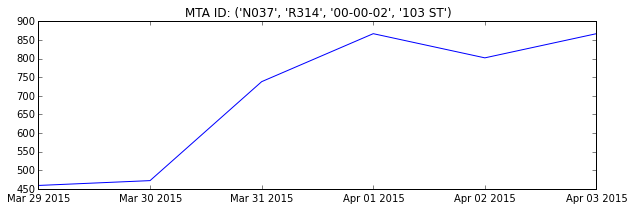

In [5]:
#challenge 4
%matplotlib inline
import matplotlib.pyplot as plt
import random
nrTurnstiles = len(turnstile_per_day_dict)
randomTurnstileKey = turnstile_per_day_dict.keys()[random.randint(0,nrTurnstiles-1)]
dates = []
counts = []
#avoiding first elem as it is always 
for elem in turnstile_per_day_dict[randomTurnstileKey]:    
        # Elements are already sorted per day
    dates.append(elem[0])
    counts.append(elem[1])
plt.figure(figsize=(10,3))
plt.title('MTA ID: %s' % str(randomTurnstileKey))
plt.plot(dates,counts)

#print dates
#print counts
print turnstile_per_day_dict[randomTurnstileKey]
turnstile_per_day_dict.keys()[random.randint(0,nrTurnstiles-1)]


In [6]:
#challenge 5
def group_Vals_Per_ControlArea_UnitStation(mydict):
    result_Dict = {}
    tmp_Dict = {}
    for k,v in mydict.items():
        new_Key = (k[0],k[1],k[3])
        if not new_Key in tmp_Dict:
            tmp_Dict[new_Key] = {} # Work with a nested dict
        for elem in v:
            if elem[0] not in tmp_Dict[new_Key]:
                tmp_Dict[new_Key][elem[0]]=0
            tmp_Dict[new_Key][elem[0]]+=elem[1]
    # Convert the nested dict into a list sorted by datetime
   
    for k,v in tmp_Dict.items():
        sorted_List = []
        for dt in sorted(v.keys()):
            #print v[dt]
            sorted_List.append([dt,v[dt]])
        result_Dict[k]=sorted_List
    return result_Dict
Vals_Per_ControlArea_UnitStation_dict=group_Vals_Per_ControlArea_UnitStation(turnstile_per_day_dict) 
print Vals_Per_ControlArea_UnitStation_dict


{('N325A', 'R218', 'ELMHURST AVE'): [[datetime.datetime(2015, 3, 29, 0, 0), 9032], [datetime.datetime(2015, 3, 30, 0, 0), 8419], [datetime.datetime(2015, 3, 31, 0, 0), 13851], [datetime.datetime(2015, 4, 1, 0, 0), 13987], [datetime.datetime(2015, 4, 2, 0, 0), 14185], [datetime.datetime(2015, 4, 3, 0, 0), 14250]], ('R137', 'R031', '34 ST-PENN STA'): [[datetime.datetime(2015, 3, 29, 0, 0), 0], [datetime.datetime(2015, 3, 30, 0, 0), 0], [datetime.datetime(2015, 3, 31, 0, 0), 3631], [datetime.datetime(2015, 4, 1, 0, 0), 4119], [datetime.datetime(2015, 4, 2, 0, 0), 3968], [datetime.datetime(2015, 4, 3, 0, 0), 4054]], ('R414', 'R162', 'ELDER AVE'): [[datetime.datetime(2015, 3, 29, 0, 0), 4191], [datetime.datetime(2015, 3, 30, 0, 0), 3412], [datetime.datetime(2015, 3, 31, 0, 0), 6800], [datetime.datetime(2015, 4, 1, 0, 0), 6846], [datetime.datetime(2015, 4, 2, 0, 0), 7169], [datetime.datetime(2015, 4, 3, 0, 0), 7008]], ('D012', 'R395', 'KINGS HIGHWAY'): [[datetime.datetime(2015, 3, 29, 0, 0),

In [7]:
'''#challenge 5 failed effort at an elegant solution 
Count_per_CA_St_Unit_day = {}
for fullturnstilekey, rows in turnstile_per_day_dict.items():    
    newKey = (fullturnstilekey[0],fullturnstilekey[1],fullturnstilekey[3])
    Count_per_CA_St_Unit_day[newKey]={}
    for date, cumulative_day in rows:
        day = date
        Count_per_CA_St_Unit_day[newKey][day]= Count_per_CA_St_Unit_day[newKey].get(day,0) + cumulative_day

print Count_per_CA_St_Unit_day
print fullturnstilekey'''

'#challenge 5 failed effort at an elegant solution \nCount_per_CA_St_Unit_day = {}\nfor fullturnstilekey, rows in turnstile_per_day_dict.items():    \n    newKey = (fullturnstilekey[0],fullturnstilekey[1],fullturnstilekey[3])\n    Count_per_CA_St_Unit_day[newKey]={}\n    for date, cumulative_day in rows:\n        day = date\n        Count_per_CA_St_Unit_day[newKey][day]= Count_per_CA_St_Unit_day[newKey].get(day,0) + cumulative_day\n\nprint Count_per_CA_St_Unit_day\nprint fullturnstilekey'